<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Synthetic-Data-Generation-Experiments" data-toc-modified-id="Synthetic-Data-Generation-Experiments-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Synthetic Data Generation Experiments</a></span></li><li><span><a href="#Convenience-Functions" data-toc-modified-id="Convenience-Functions-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Convenience Functions</a></span></li><li><span><a href="#Get-some-data." data-toc-modified-id="Get-some-data.-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Get some data.</a></span></li><li><span><a href="#Extracting-SPY-sector-ETFs" data-toc-modified-id="Extracting-SPY-sector-ETFs-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Extracting SPY sector ETFs</a></span><ul class="toc-item"><li><span><a href="#View-example-plots-with-XLE" data-toc-modified-id="View-example-plots-with-XLE-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>View example plots with <code>XLE</code></a></span></li><li><span><a href="#Select-the-bootstrap-parameters-and-run" data-toc-modified-id="Select-the-bootstrap-parameters-and-run-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Select the bootstrap parameters and run</a></span></li></ul></li><li><span><a href="#Correlation-Investigation" data-toc-modified-id="Correlation-Investigation-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Correlation Investigation</a></span><ul class="toc-item"><li><span><a href="#correlation-between-sectors" data-toc-modified-id="correlation-between-sectors-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>correlation between sectors</a></span></li><li><span><a href="#correlation-between-real-and-synthetic-series" data-toc-modified-id="correlation-between-real-and-synthetic-series-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>correlation between real and synthetic series</a></span></li></ul></li><li><span><a href="#Generate-synthetics-for-all-sectors" data-toc-modified-id="Generate-synthetics-for-all-sectors-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Generate synthetics for all sectors</a></span></li><li><span><a href="#Examine-correlations-across-synthetic-realizations" data-toc-modified-id="Examine-correlations-across-synthetic-realizations-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Examine correlations across synthetic realizations</a></span></li><li><span><a href="#Regenerate-synthetics-with-larger-blocks" data-toc-modified-id="Regenerate-synthetics-with-larger-blocks-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Regenerate synthetics with larger blocks</a></span></li><li><span><a href="#Regenerate-Synthetics-with-Smaller-Blocks" data-toc-modified-id="Regenerate-Synthetics-with-Smaller-Blocks-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Regenerate Synthetics with Smaller Blocks</a></span></li><li><span><a href="#Additional-ETF-synthetics" data-toc-modified-id="Additional-ETF-synthetics-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Additional ETF synthetics</a></span><ul class="toc-item"><li><span><a href="#Rolling-Volatility" data-toc-modified-id="Rolling-Volatility-10.1"><span class="toc-item-num">10.1&nbsp;&nbsp;</span>Rolling Volatility</a></span></li></ul></li></ul></div>

## Synthetic Data Generation Experiments

In this notebook I experiment with synthetic data generation using block bootstrap methods available from the `arch` package. The basic idea is to compare the aspects of the real series with the bootstrapped versions. 

In [1]:
%load_ext autoreload
%autoreload 2

%load_ext watermark

from pathlib import Path
import time 
from pprint import pprint, pformat

import pandas as pd
import numpy as np
import scipy.stats as stats
import statsmodels.api as sm
import numba as nb
from arch.bootstrap import CircularBlockBootstrap

# import visual tools
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import seaborn as sns

sns_params = {
    'font.size':9.5,
    'font.weight':'medium',
    'figure.figsize':(10,7),
}

plt.style.use('seaborn-talk')
plt.style.use('bmh')
#plt.style.use('dark_background')
sns.set_context(sns_params)
savefig_kwds=dict(dpi=300, bbox_inches='tight', frameon=True, format='png')
nanex_colors = ("#f92b20", "#fe701b", "#facd1f", "#d6fd1c", "#65fe1b",
                "#1bfe42", "#1cfdb4", "#1fb9fa", "#1e71fb", "#261cfd")
nanex_cmap = mpl.colors.ListedColormap(nanex_colors,name='nanex_cmap')
plt.register_cmap('nanex_cmap', cmap=nanex_cmap)
# import util libs
from tqdm import tqdm, tqdm_notebook
import warnings
warnings.filterwarnings("ignore")

from src.tools.pystore_tools import *
from src.tools.utils import *
from src.CONSTANTS import PROJECT_REPO_NAME

pdir = get_relative_project_dir(
    project_repo_name=PROJECT_REPO_NAME, partial=False)
data_dir = Path(pdir/'data')

%watermark -v -m -g
print()
%watermark --iversions

CPython 3.7.2
IPython 6.5.0

compiler   : GCC 7.3.0
system     : Linux
release    : 4.19.11-041911-generic
machine    : x86_64
processor  : x86_64
CPU cores  : 12
interpreter: 64bit
Git hash   :

pandas      0.23.4
numpy       1.15.4
numba       0.41.0
matplotlib  3.0.2
seaborn     0.9.0
pystore     0.1.5
dask        1.0.0
logzero     1.5.0



## Convenience Functions

Below I have aggregated some convenience functions to plot the various statistics such as mean, std, min, max, and autocorrelation structures between the real series and the synthetic. The plots also feature comparisons of the indexed price series among the various realizations.

In [2]:
def plot_autocorr(s, lags=50, figsize=(10,7), title=None): 
    fig = plt.figure(figsize=figsize)
    layout = 2, 2
    acf_ax = plt.subplot2grid(layout, (0, 0))
    abs_acf_ax = plt.subplot2grid(layout, (0, 1))
    pacf_ax = plt.subplot2grid(layout, (1, 0))
    squared_ax = plt.subplot2grid(layout, (1, 1))
    
    sm.graphics.tsa.plot_acf(s, fft=True, zero=False, lags=lags, ax=acf_ax,
                             title='Autocorrelation of Returns');
    
    sm.graphics.tsa.plot_acf(s.abs(), fft=True, zero=False,
                             lags=lags, ax=abs_acf_ax,
                             title='Autocorrelation of Absolute Returns');
    
    sm.graphics.tsa.plot_pacf(s, zero=False, lags=lags, ax=pacf_ax,
                              title='Partial Autocorrelation of Returns');
    
    sm.graphics.tsa.plot_acf(s**2, fft=True, zero=False,
                             lags=lags, ax=squared_ax,
                             title='Autocorrelation of Squared Returns');
    
    if title: fig.suptitle(title, fontweight='demi', fontsize=16)
    fig.tight_layout()
    fig.subplots_adjust(top=0.88)
    return

def plot_mean_dist(returns, sim_returns, ax):
    
    mean_return = returns.mean()
    
    ax.set_title(f'{returns.name} mean return: {mean_return:.4f}')
    sim_means = sim_returns.mean().squeeze()

    g = sns.distplot(sim_means, kde=False, ax=ax)
    g.axvline(mean_return, color='r')    
    return
    
def plot_std_dist(returns, sim_returns, ax):
    
    std = returns.std()
    
    ax.set_title(f'{returns.name} return std: {std:.4f}')
    sim_stds = sim_returns.std().squeeze()

    g = sns.distplot(sim_stds, kde=False, ax=ax)
    g.axvline(std, color='r')    
    return

def plot_min_dist(returns, sim_returns, ax):
    
    min_ = returns.min()
    
    ax.set_title(f'{returns.name} return min: {min_:.4f}')
    sim_mins = sim_returns.min().squeeze()

    g = sns.distplot(sim_mins, kde=False, ax=ax)
    g.axvline(min_, color='r')    
    return

def plot_max_dist(returns, sim_returns, ax):
    
    max_ = returns.max()
    
    ax.set_title(f'{returns.name} return max: {max_:.4f}')
    sim_maxs = sim_returns.max().squeeze()

    g = sns.distplot(sim_maxs, kde=False, ax=ax)
    g.axvline(max_, color='r')    
    return

def plot_autocorr_dist(returns, sim_returns, ax):
    
    autocorr = returns.autocorr()

    ax.set_title(f'{returns.name} return autocorr: {autocorr:.4f}')
    sim_autocorrs = sim_returns.apply(pd.Series.autocorr).squeeze()

    g = sns.distplot(sim_autocorrs, kde=False, ax=ax)
    g.axvline(autocorr, color='r') 
    return

def plot_stat_dist(returns, sim_returns, figsize=(10,7)):
    fig = plt.figure(figsize=figsize, constrained_layout=True)
    gs = fig.add_gridspec(3, 2)
    plot_mean_dist(returns, sim_returns, fig.add_subplot(gs[0,0]))
    plot_std_dist(returns, sim_returns, fig.add_subplot(gs[0,1]))
    plot_min_dist(returns, sim_returns, fig.add_subplot(gs[1,0])) 
    plot_max_dist(returns, sim_returns, fig.add_subplot(gs[1,1])) 
    plot_autocorr_dist(returns, sim_returns, fig.add_subplot(gs[2,:]))
    
    fig.suptitle(f'{returns.name} simulated stat distributions',
                 fontweight='demi', fontsize=16)
    fig.tight_layout()
    fig.subplots_adjust(top=0.88)
    return



In [3]:
def to_returns(s): return np.log(s/s.shift(1)).dropna()

def to_price_index(df, start=100):
    return (start * (np.exp(df.cumsum())))

def cdescribe(x, n_cols=None):
    if not n_cols:
        d = x.describe()
        d.loc['skew'] = x.skew()
        d.loc['kurtosis'] = x.kurtosis()
        return d
    else:
        x_ = x.sample(n_cols, axis=1)
        d = x_.describe()
        d.loc['skew'] = x_.skew()
        d.loc['kurtosis'] = x_.kurtosis()        
        return d
    
def CBB(s, blocksize, N_paths):
    sim_returns = []

    bs = CircularBlockBootstrap(blocksize, s)#, x, y=y, z=z)
    for i, data in enumerate(tqdm_notebook(bs.bootstrap(N_paths))):
        tmp = data[0][0].reset_index(drop=True)
        #tmp.name = f'{i}_run'
        sim_returns.append(tmp)
    simulations = pd.concat(sim_returns, axis=1, ignore_index=True)
    return simulations      

def compare_stats(x, y, n_cols=None):
    pd.options.display.float_format = '{:,.4f}'.format
    data = (pd.concat([cdescribe(x), cdescribe(y, n_cols=n_cols)], axis=1))
    return data

In [4]:
def view_all(real, sims, n_cols=20, cmap=None):
    plt.set_cmap(cmap)
    compare_stats(real, sims, n_cols=20)
    plot_stat_dist(real, sims)
    plot_autocorr(real, title=f'{real.name} Real Returns')
    rand_col = np.random.randint(len(sims.columns), size=1)[0]
    plot_autocorr(sims[rand_col], 
                  title=f'Simulated Return Path {rand_col}')
    return
    
def plot_realizations(real, sims, start, n_plot_paths=50, figsize=(10,7), cmap=None):   
    plt.set_cmap(cmap)
    sim_prices = to_price_index(sims, start=100)

    fig, ax = plt.subplots(figsize=figsize)
    (sim_prices.sample(n_plot_paths, axis=1)
     .plot(legend=False, alpha=0.7, lw=1., ax=ax))
    (to_price_index(real.reset_index(drop=True))
     .plot(legend=True, ax=ax, lw=5, ls='--', color='k'))
    plt.title(f'{real.name} {n_plot_paths} simulated price paths')

## Get some data.

Below is intraday data from the `iex` trading exchange sampled at a 30 sec resolution, resampled to 1 mean using the mean price over the period. The data covers approximately 3 months ending in December 2018.

In [5]:
infp = Path(data_dir/'processed'/'etf_symbols_01.parq')
all_df = pd.read_parquet(infp).swaplevel().sort_index()
cprint(all_df)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
                            lastSalePrice  lastSaleSize         volume  \
dates               symbol                                               
2018-12-31 13:59:00 XME         26.100000    603.333333   18626.000000   
                    XOP         26.425000     74.000000  394477.333333   
                    XPH         36.490000    200.000000    1328.000000   
                    XRT         40.868333    175.333333  134839.333333   
                    XSD         64.600000    100.000000     200.000000   

                               spread  mid_price  dollar_volume  
dates               symbol                                       
2018-12-31 13:59:00 XME      0.060000  26.130000      486141.60  
                    XOP    -17.610000  17.611667    10424067.99  
                    XPH      0.0000

In [6]:
prices = all_df['lastSalePrice'].unstack()
cprint(prices)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                    AAXJ       ACWI    ACWV   ACWX         AGG     BIL  \
dates                                                                          
2018-12-31 13:55:00  63.971667  63.971667  81.090  41.86  106.455000  91.455   
2018-12-31 13:56:00  63.990000  63.990000  81.035  41.86  106.455000  91.455   
2018-12-31 13:57:00  63.905000  63.905000  81.035  41.86  106.465000  91.455   
2018-12-31 13:58:00  63.900000  63.900000  81.030  41.86  106.481667  91.455   
2018-12-31 13:59:00  63.936667  63.936667  81.030  41.86  106.498333  91.455   

symbol                  BIV    BKF        BLV        BND  ...         XLK  \
dates                                                     ...               
2018-12-31 13:55:00  81.265  37.45  87.420000  79.180000  ...   61.696667   
2018-12-31 13:56:00  81.26

## Extracting SPY sector ETFs

In [7]:
sector = [x for x in prices.columns if x.startswith('XL')]
sectors = prices[sector].dropna()
cprint(sectors)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                     XLB        XLE        XLF        XLI        XLK  \
dates                                                                        
2018-12-31 13:55:00  50.290000  57.011667  23.693333  64.116667  61.696667   
2018-12-31 13:56:00  50.278333  57.060000  23.713333  64.128333  61.706667   
2018-12-31 13:57:00  50.195000  56.940000  23.666667  63.996667  61.536667   
2018-12-31 13:58:00  50.190000  56.990000  23.668333  64.003333  61.586667   
2018-12-31 13:59:00  50.250000  57.091667  23.700000  64.076667  61.643333   

symbol                     XLP        XLU        XLV        XLY  
dates                                                            
2018-12-31 13:55:00  50.583333  52.821667  86.020000  98.538333  
2018-12-31 13:56:00  50.623333  52.841667  86.046667  98.610000  
2018-12

compute the returns.

In [8]:
sector_returns = to_returns(sectors).dropna()

### View example plots with `XLE`

In [9]:
xle = sector_returns['XLE']
cprint(xle)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
                          XLE
dates                        
2018-12-31 13:55:00  0.000556
2018-12-31 13:56:00  0.000847
2018-12-31 13:57:00 -0.002105
2018-12-31 13:58:00  0.000878
2018-12-31 13:59:00  0.001782
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 20028 entries, 2018-10-01 07:33:00 to 2018-12-31 13:59:00
Data columns (total 1 columns):
XLE    20028 non-null float64
dtypes: float64(1)
memory usage: 312.9 KB
None
-------------------------------------------------------------------------------



### Select the bootstrap parameters and run

In [10]:
N_paths = 1_000
block_size = 100
xle_sims = CBB(xle, blocksize=block_size, N_paths=N_paths)

<Figure size 432x288 with 0 Axes>

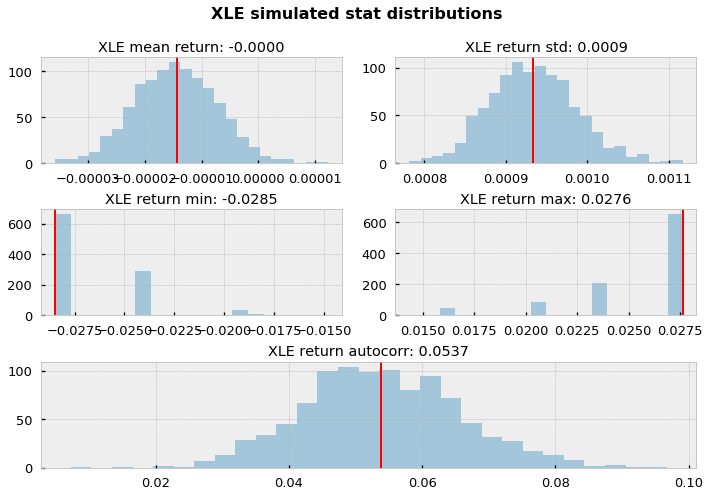

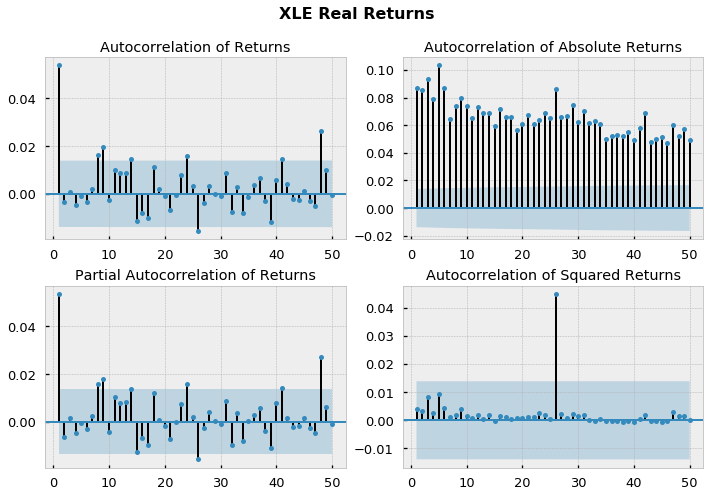

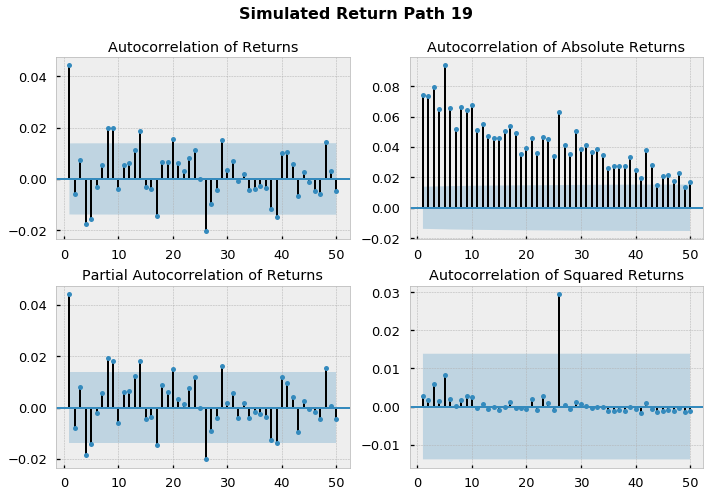

In [11]:
view_all(xle, xle_sims, cmap=None)

<Figure size 432x288 with 0 Axes>

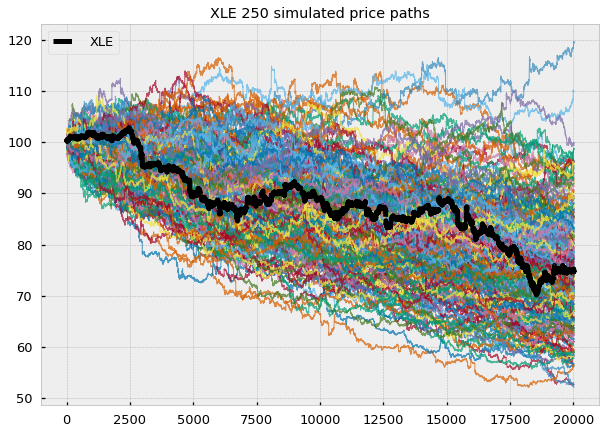

In [12]:
plot_realizations(xle, xle_sims, start=100, 
                  n_plot_paths=250, cmap='nanex_cmap')

## Correlation Investigation

### correlation between sectors

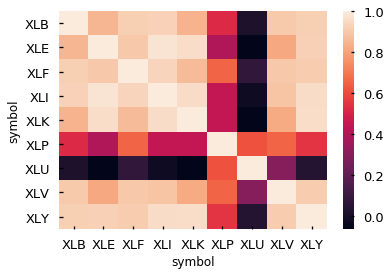

In [13]:
sns.heatmap(sectors.corr())

### correlation between real and synthetic series

In [14]:
concat = pd.concat([xle.reset_index(drop=True), xle_sims],axis=1)
concat.corrwith(concat['XLE'])

XLE    1.0000
0      0.0009
1      0.0078
2      0.0093
3     -0.0098
4      0.0101
5      0.0148
6      0.0009
7      0.0042
8      0.0032
9     -0.0007
10    -0.0015
11     0.0035
12    -0.0129
13    -0.0155
14     0.0008
15    -0.0027
16     0.0148
17     0.0012
18    -0.0007
19    -0.0084
20    -0.0025
21     0.0027
22    -0.0102
23     0.0039
24     0.0047
25    -0.0075
26    -0.0005
27    -0.0003
28    -0.0093
        ...  
970    0.0097
971    0.0011
972    0.0014
973    0.0118
974   -0.0086
975    0.0028
976   -0.0022
977    0.0105
978    0.0004
979   -0.0010
980   -0.0004
981    0.0033
982    0.0025
983   -0.0038
984    0.0088
985    0.0030
986   -0.0060
987   -0.0009
988    0.0096
989   -0.0049
990    0.0002
991    0.0030
992   -0.0081
993   -0.0095
994    0.0006
995   -0.0141
996   -0.0011
997    0.0086
998    0.0001
999    0.0117
Length: 1001, dtype: float64

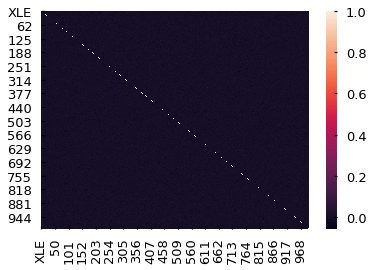

In [15]:
sns.heatmap(concat.corr())

## Generate synthetics for all sectors

<Figure size 432x288 with 0 Axes>

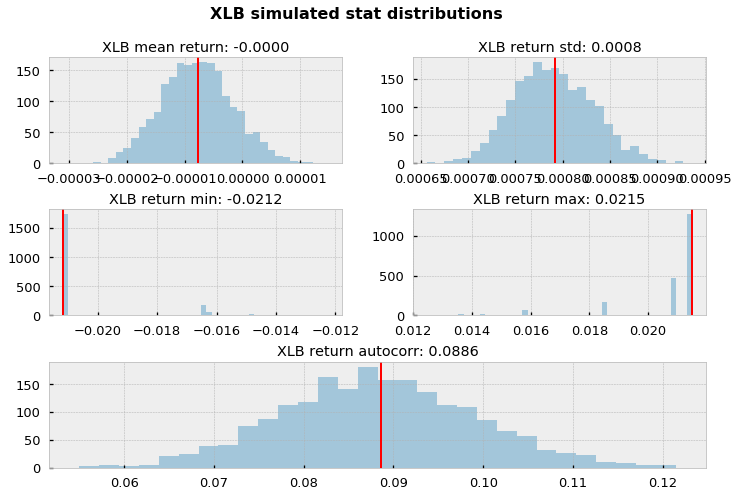

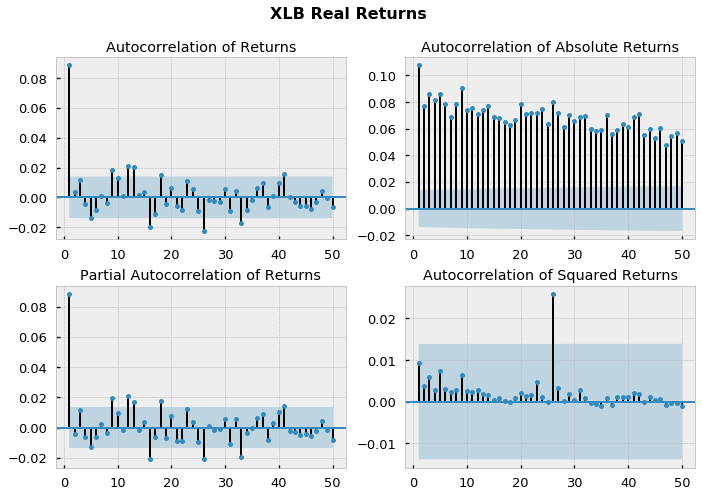

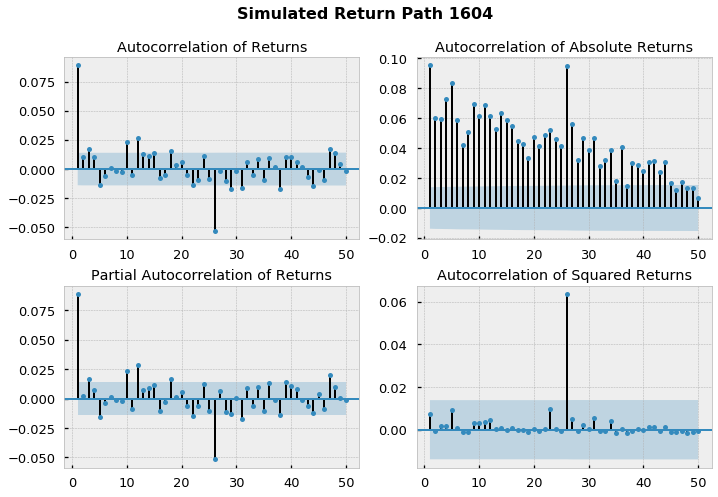

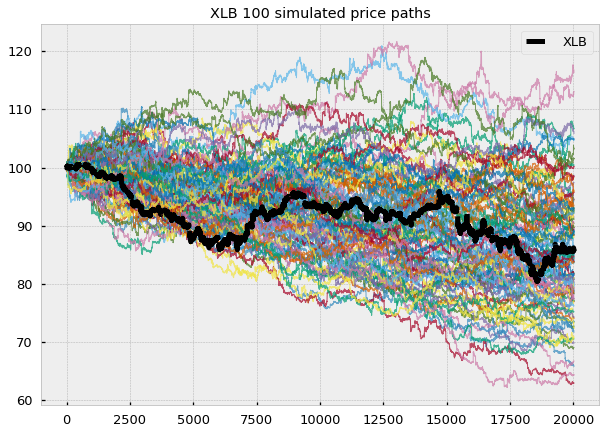

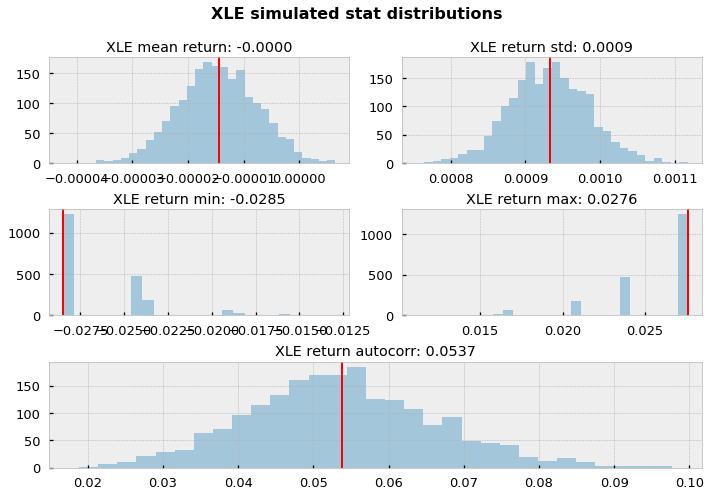

...

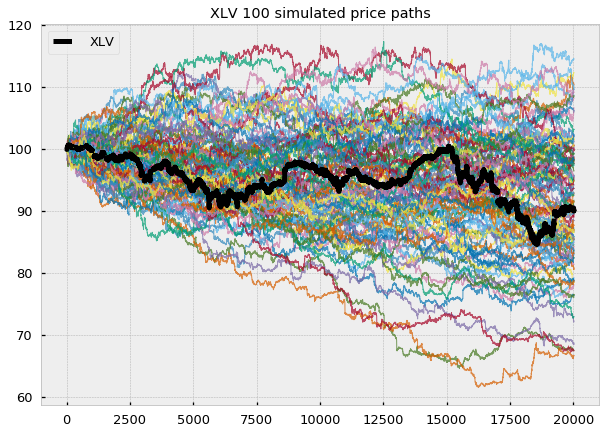

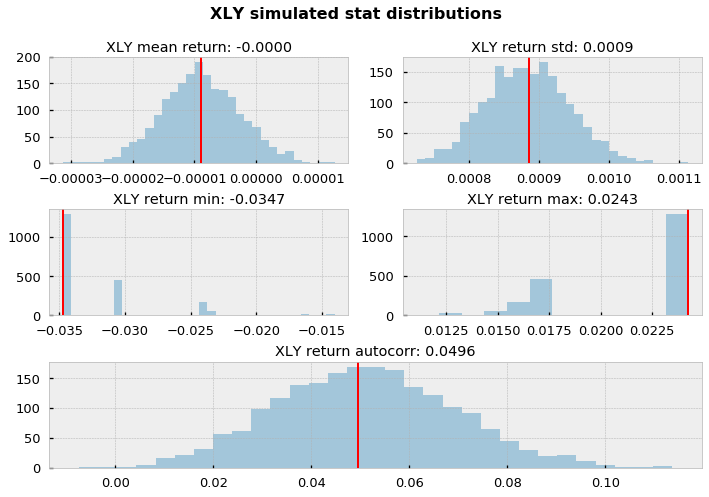

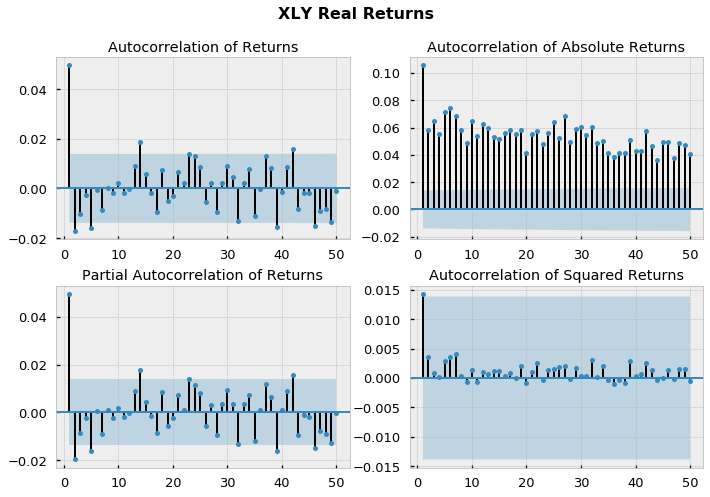

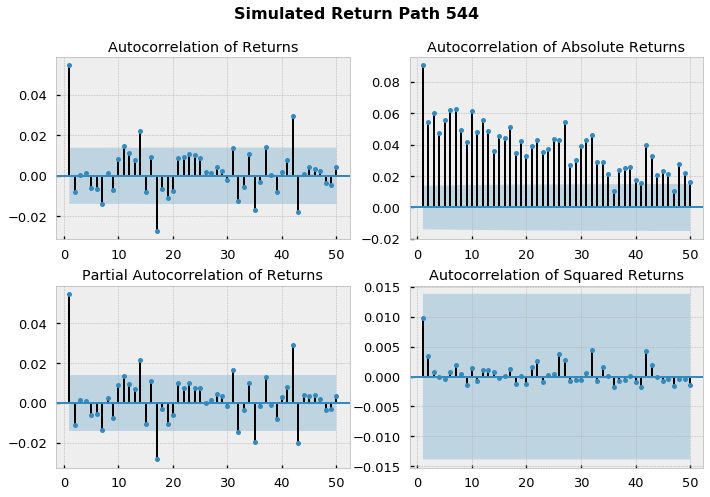

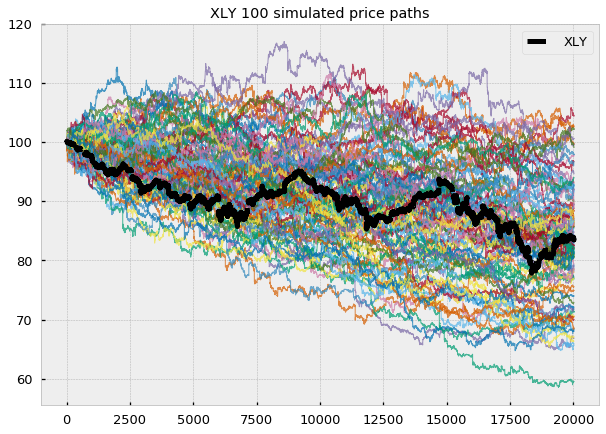

In [16]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    block_size = 100
    sec_sims = CBB(tmp, blocksize=block_size, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

## Examine correlations across synthetic realizations

In this section I try to select a random sampling of synthetic realizations and blend them together. Once blended I examine the correlation between the different synthetics that were generated using each of the real sector returns.

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
          XLB     XLE     XLF     XLI     XLK     XLP     XLU     XLV     XLY
20023 -0.0001  0.0005 -0.0002 -0.0005  0.0002  0.0000  0.0001  0.0002 -0.0001
20024 -0.0002  0.0000  0.0001  0.0000 -0.0001  0.0002  0.0002  0.0001  0.0005
20025 -0.0001 -0.0004  0.0000  0.0005 -0.0004 -0.0003 -0.0000  0.0001  0.0001
20026 -0.0001 -0.0000  0.0003 -0.0001 -0.0001  0.0001  0.0001  0.0002  0.0000
20027 -0.0000 -0.0002 -0.0001 -0.0003  0.0001  0.0001  0.0000 -0.0000 -0.0001
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20028 entries, 0 to 20027
Data columns (total 9 columns):
XLB    20028 non-null float64
XLE    20028 non-null float64
XLF    20028 non-null float64
XLI    20028 non-null float64
XLK    20028 non-null float64
XLP    20028 non-null float64
XLU    2002

,XLB,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY
XLB,1.0000,0.0014,-0.0084,0.0103,0.0004,0.0008,0.0001,0.0142,0.0126
XLE,0.0014,1.0000,0.0059,0.0150,-0.0002,0.0047,-0.0125,-0.0019,-0.0050
XLF,-0.0084,0.0059,1.0000,-0.0059,-0.0072,-0.0054,0.0044,-0.0026,0.0042
XLI,0.0103,0.0150,-0.0059,1.0000,-0.0049,-0.0051,0.0121,0.0012,-0.0036
XLK,0.0004,-0.0002,-0.0072,-0.0049,1.0000,0.0028,-0.0028,0.0070,0.0029
XLP,0.0008,0.0047,-0.0054,-0.0051,0.0028,1.0000,-0.0046,-0.0008,0.0005
XLU,0.0001,-0.0125,0.0044,0.0121,-0.0028,-0.0046,1.0000,0.0030,0.0033
XLV,0.0142,-0.0019,-0.0026,0.0012,0.0070,-0.0008,0.0030,1.0000,-0.0083
XLY,0.0126,-0.0050,0.0042,-0.0036,0.0029,0.0005,0.0033,-0.0083,1.0000


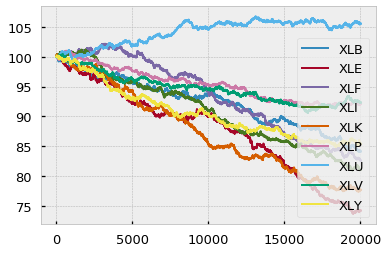

In [17]:
n_cols = 10
merged = dict()

for sym in sim_dict.keys():
    np.random.seed(0)
    tmp = sim_dict[sym]
    # pick random set of columns
    col_idx = np.random.randint(0, len(tmp.columns)+1, n_cols)
    merged[sym] = tmp[col_idx].mean(axis=1)

df = pd.DataFrame(merged)
cprint(df)

display(df.corr())

to_price_index(df).plot()

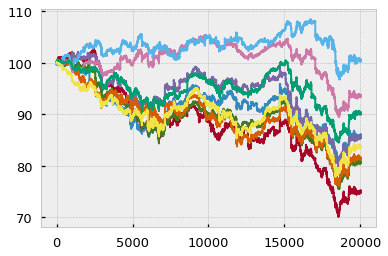

In [18]:
to_price_index(sector_returns.reset_index(drop=True)).plot(legend=False)

## Regenerate synthetics with larger blocks

In [45]:
bsize = len(sector_returns)//10
bsize

2002

<Figure size 432x288 with 0 Axes>

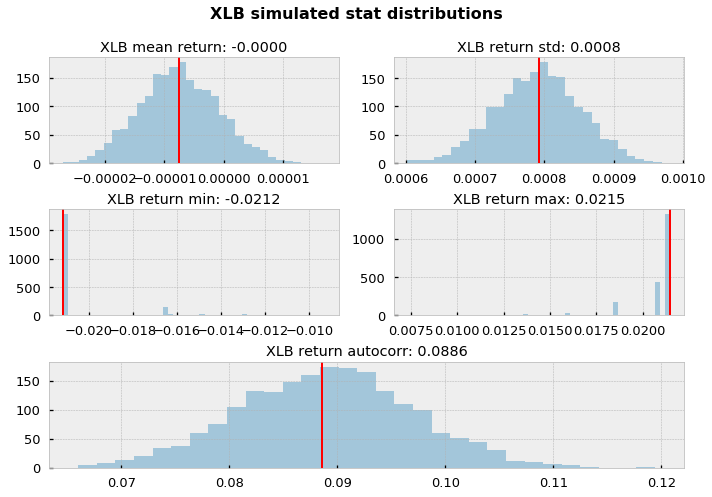

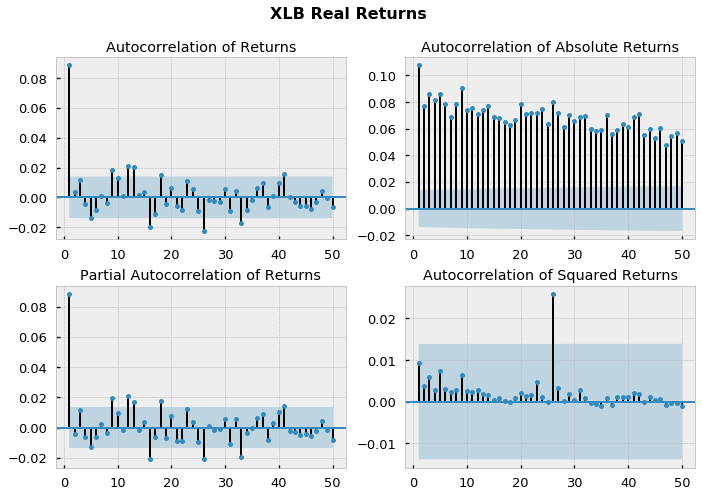

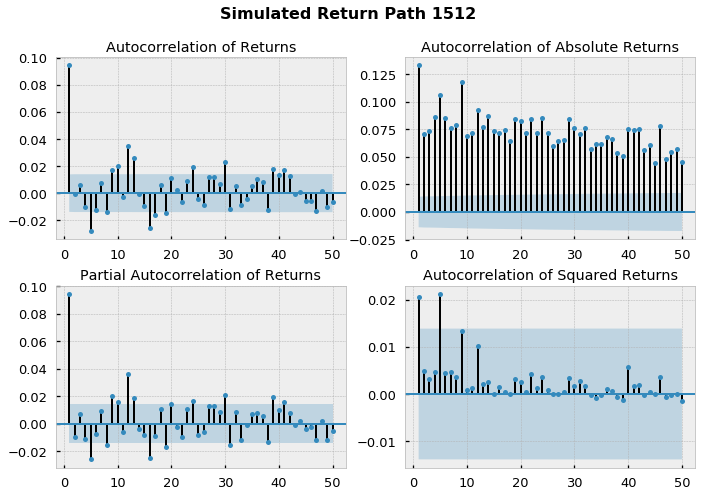

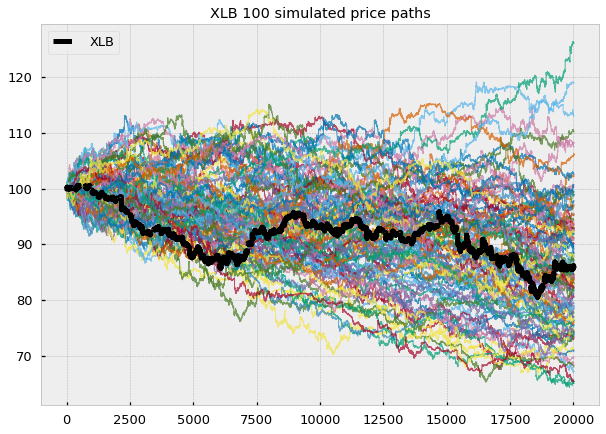

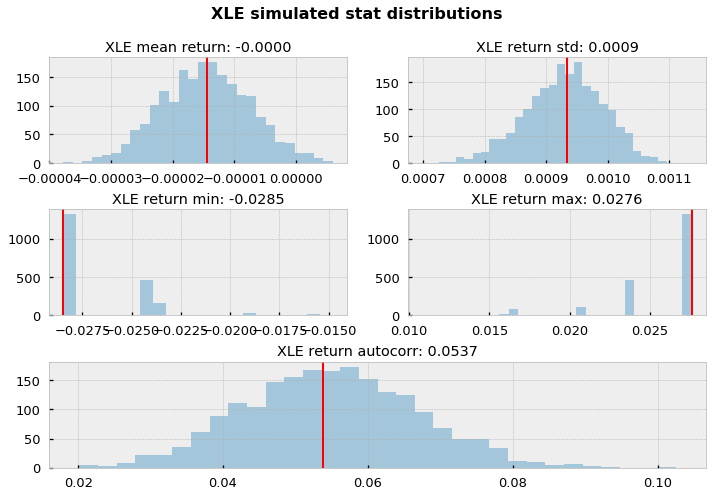

...

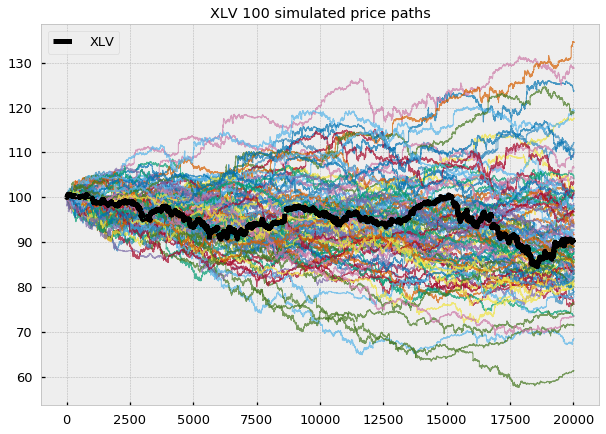

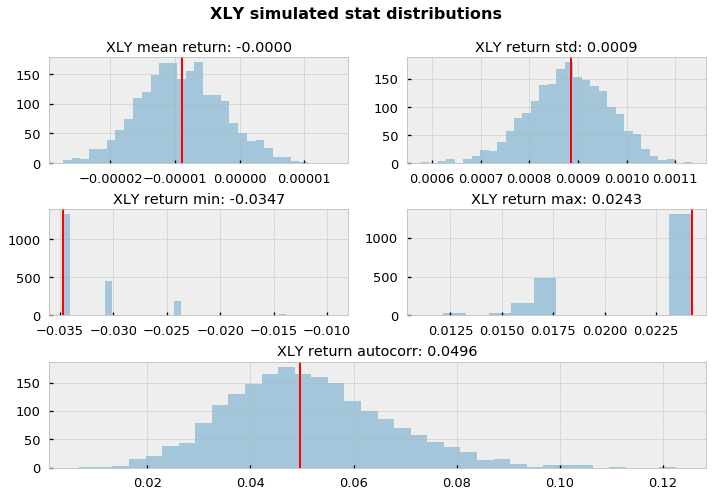

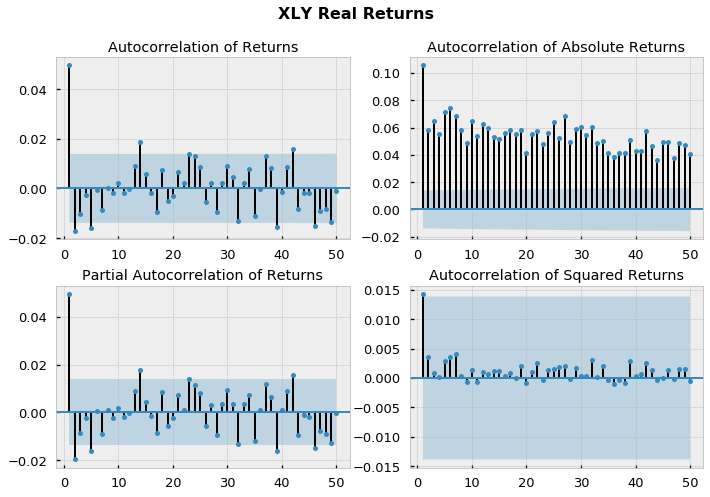

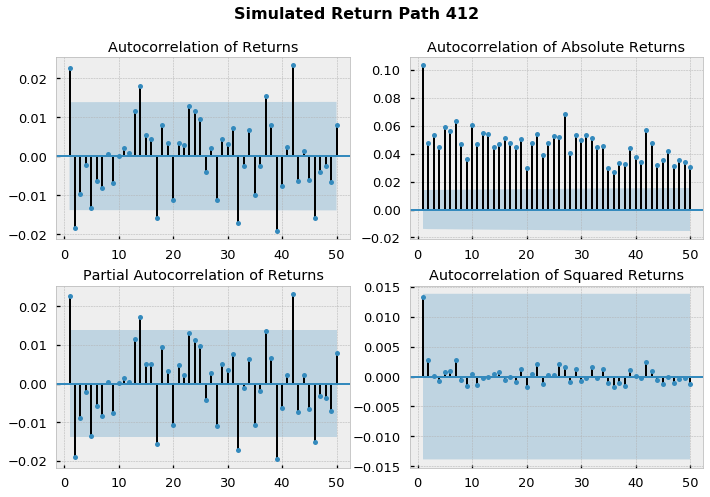

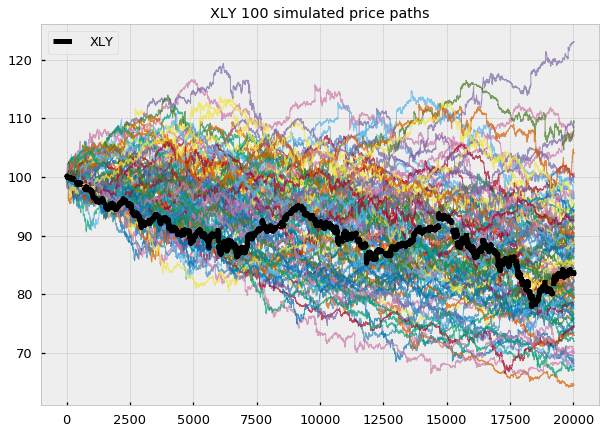

In [20]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
          XLB     XLE     XLF     XLI     XLK     XLP     XLU     XLV     XLY
20023  0.0000 -0.0005  0.0002  0.0004  0.0006  0.0004 -0.0004  0.0001 -0.0000
20024  0.0000 -0.0000 -0.0001  0.0003  0.0001  0.0004 -0.0003  0.0001  0.0000
20025 -0.0003  0.0003  0.0003 -0.0004  0.0004  0.0003 -0.0002  0.0003  0.0001
20026  0.0003  0.0006  0.0000  0.0006  0.0001  0.0001 -0.0001 -0.0001 -0.0001
20027  0.0000 -0.0005  0.0004  0.0006 -0.0003 -0.0006 -0.0002  0.0001  0.0007
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20028 entries, 0 to 20027
Data columns (total 9 columns):
XLB    20028 non-null float64
XLE    20028 non-null float64
XLF    20028 non-null float64
XLI    20028 non-null float64
XLK    20028 non-null float64
XLP    20028 non-null float64
XLU    2002

,XLB,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY
XLB,1.0000,-0.0012,-0.0049,0.0084,-0.0100,0.0102,0.0078,0.0053,-0.0033
XLE,-0.0012,1.0000,0.0015,-0.0036,-0.0003,-0.0006,0.0031,0.0071,0.0150
XLF,-0.0049,0.0015,1.0000,-0.0037,-0.0039,0.0020,-0.0081,-0.0015,0.0097
XLI,0.0084,-0.0036,-0.0037,1.0000,-0.0038,-0.0042,-0.0108,-0.0044,-0.0061
XLK,-0.0100,-0.0003,-0.0039,-0.0038,1.0000,-0.0039,0.0105,-0.0006,-0.0119
XLP,0.0102,-0.0006,0.0020,-0.0042,-0.0039,1.0000,0.0042,-0.0115,0.0014
XLU,0.0078,0.0031,-0.0081,-0.0108,0.0105,0.0042,1.0000,0.0086,-0.0009
XLV,0.0053,0.0071,-0.0015,-0.0044,-0.0006,-0.0115,0.0086,1.0000,-0.0029
XLY,-0.0033,0.0150,0.0097,-0.0061,-0.0119,0.0014,-0.0009,-0.0029,1.0000


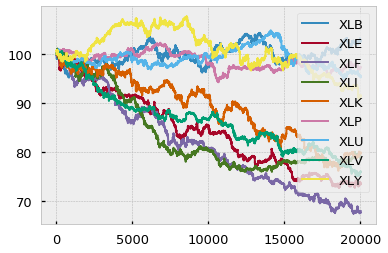

In [24]:
n_cols = 2
merged = dict()

for sym in sim_dict.keys():
    np.random.seed(0)
    tmp = sim_dict[sym]
    # pick random set of columns
    col_idx = np.random.randint(0, len(tmp.columns)+1, n_cols)
    merged[sym] = tmp[col_idx].mean(axis=1)

df = pd.DataFrame(merged)
cprint(df)

display(df.corr())

to_price_index(df).plot()

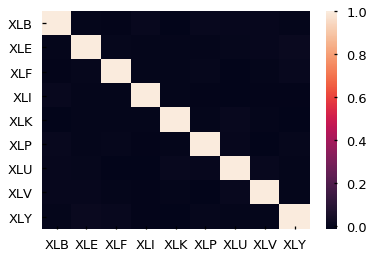

In [25]:
sns.heatmap(df.corr())

## Regenerate Synthetics with Smaller Blocks

In [46]:
bsize = len(sector_returns)//1000
bsize

20

<Figure size 432x288 with 0 Axes>

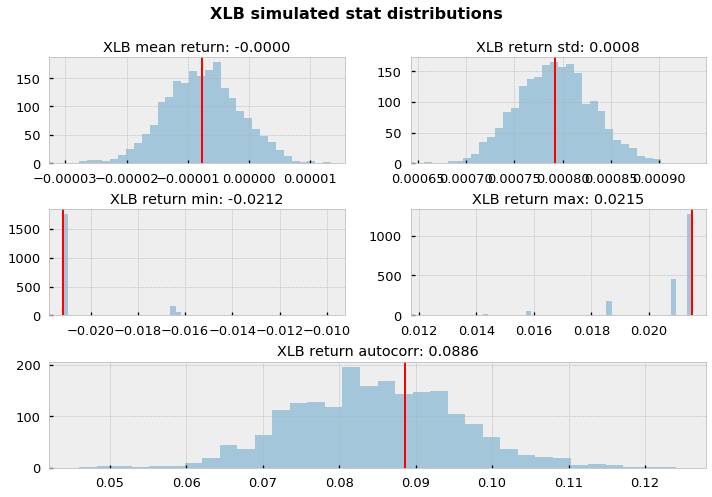

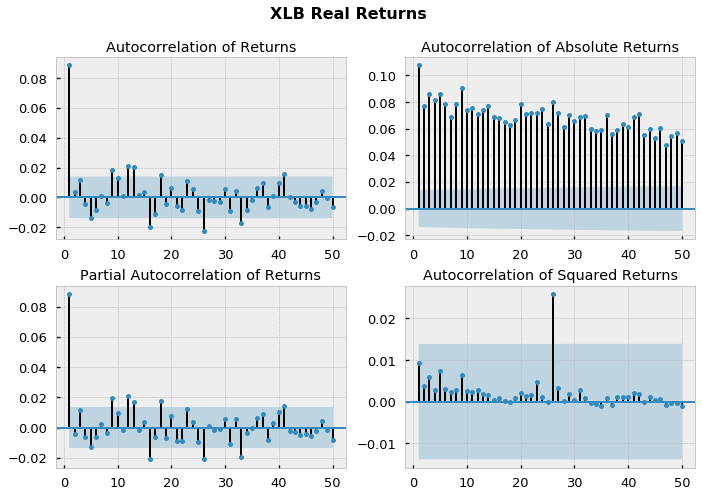

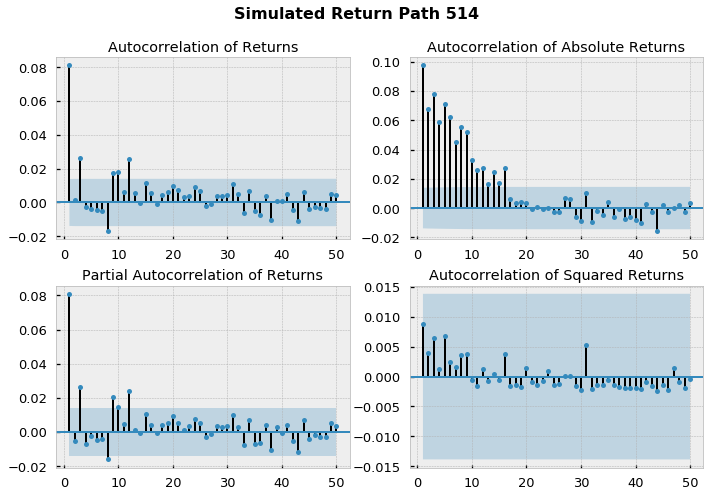

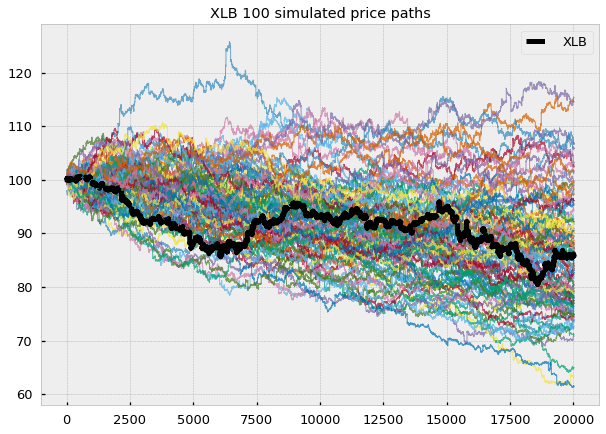

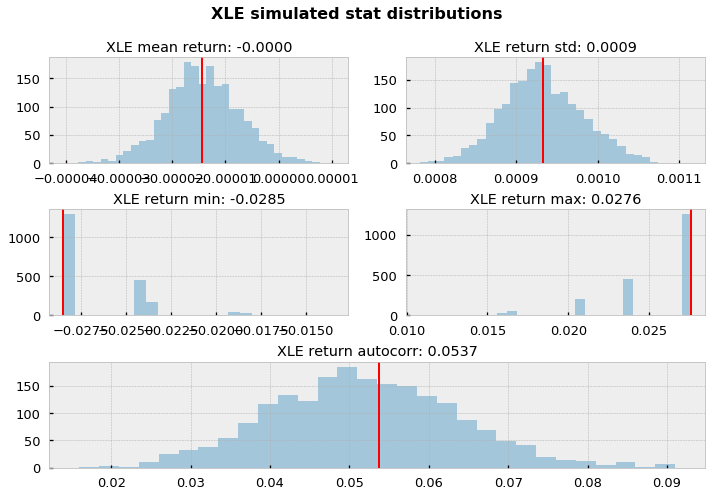

...

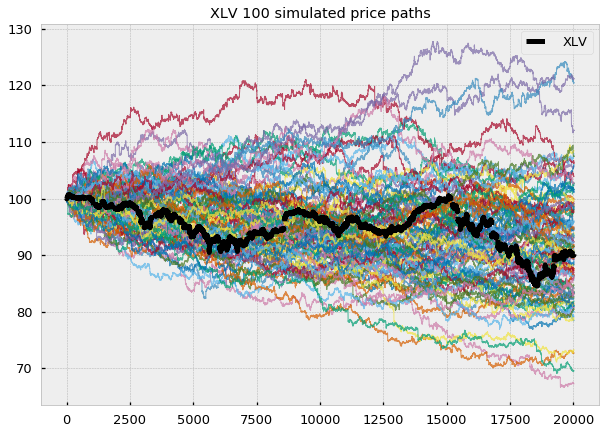

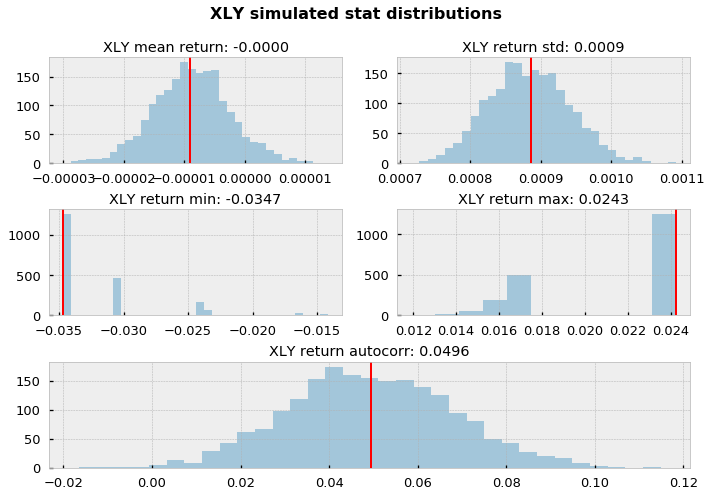

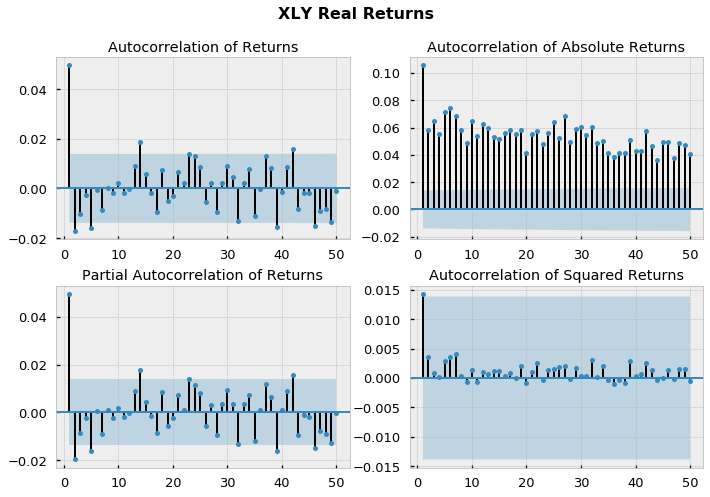

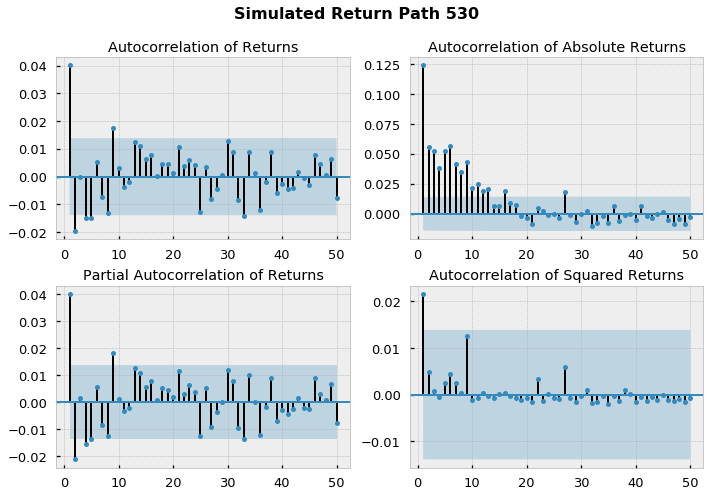

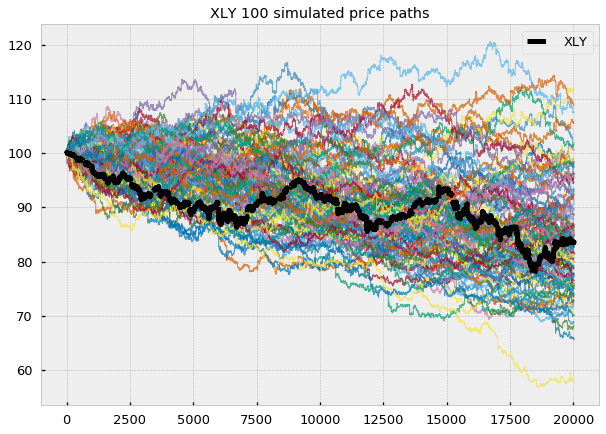

In [47]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

## Additional ETF synthetics

In [28]:
symbols = ['SPY', 'IWM', 'ACWI', 'EEM', 'GLD',
           'TLT', 'BND', 'SHY', 'LQD', 'HYG', 'VNQ']

etfs = to_returns(prices[symbols].dropna())
cprint(etfs)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                  SPY     IWM    ACWI     EEM     GLD     TLT    BND  \
dates                                                                        
2018-12-31 13:55:00  0.0006  0.0013  0.0006  0.0005 -0.0001  0.0001 0.0000   
2018-12-31 13:56:00  0.0006  0.0014  0.0003  0.0005 -0.0001  0.0000 0.0000   
2018-12-31 13:57:00 -0.0022 -0.0011 -0.0013 -0.0010 -0.0000  0.0002 0.0000   
2018-12-31 13:58:00  0.0004  0.0001 -0.0001  0.0008 -0.0001 -0.0001 0.0000   
2018-12-31 13:59:00  0.0011 -0.0002  0.0006  0.0003  0.0001  0.0001 0.0002   

symbol                  SHY     LQD     HYG     VNQ  
dates                                                
2018-12-31 13:55:00 -0.0001  0.0000  0.0002  0.0008  
2018-12-31 13:56:00 -0.0000  0.0001  0.0003  0.0019  
2018-12-31 13:57:00 -0.0001  0.0000 -0.0005 -0.0013  
2

<Figure size 432x288 with 0 Axes>

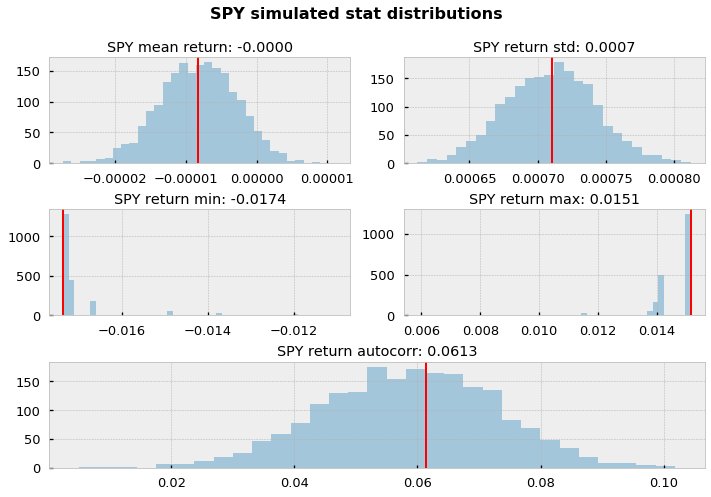

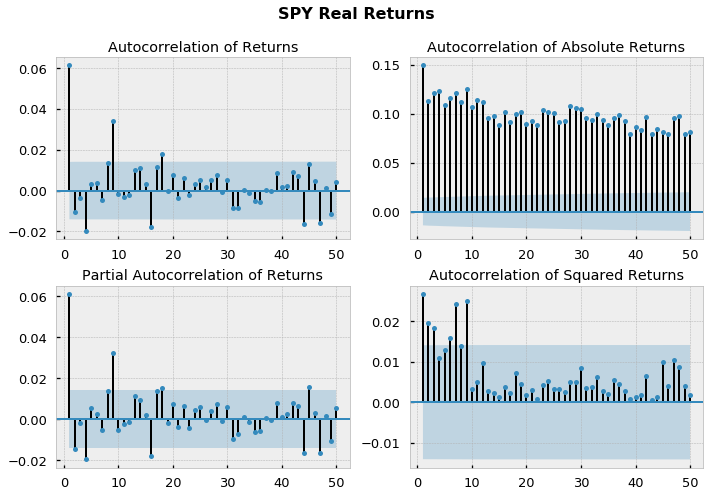

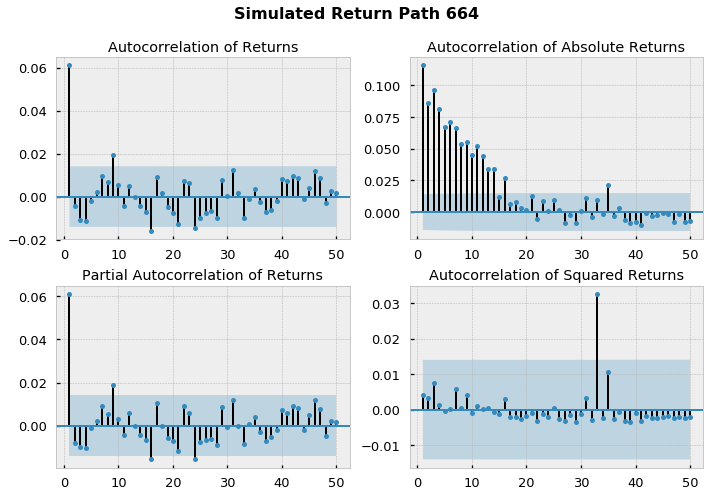

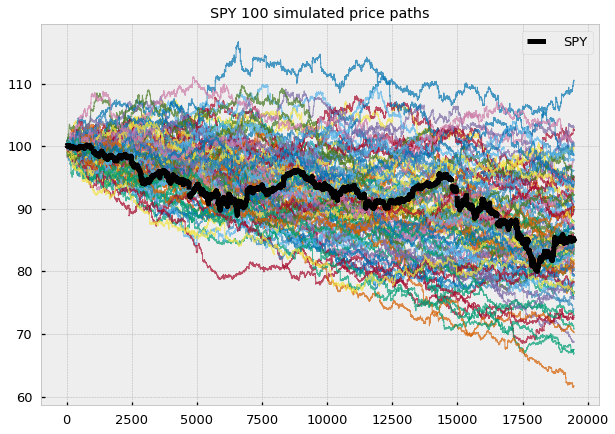

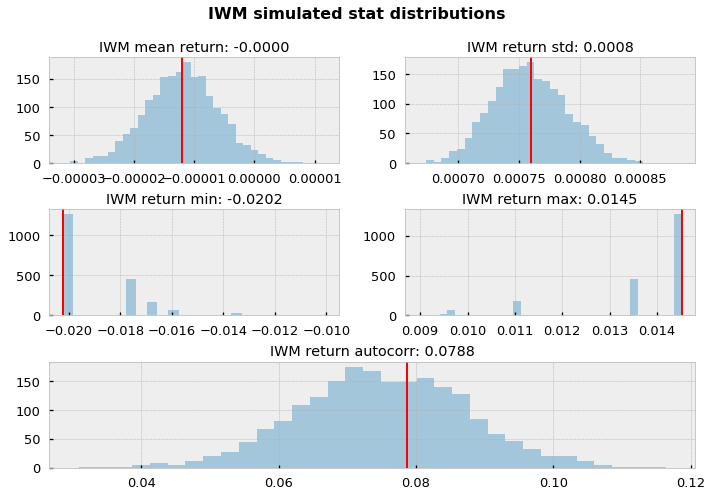

...

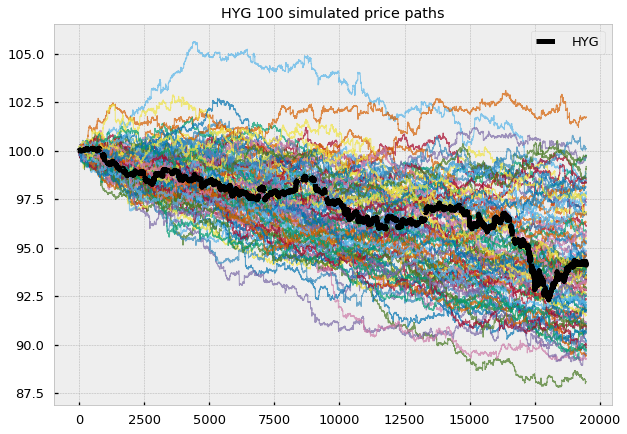

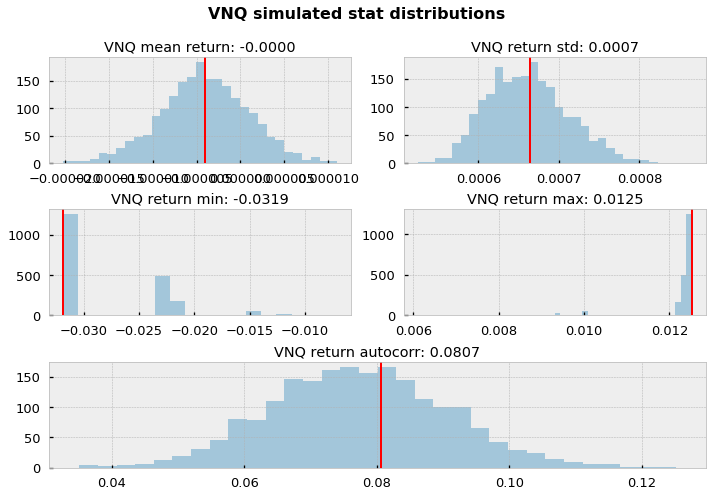

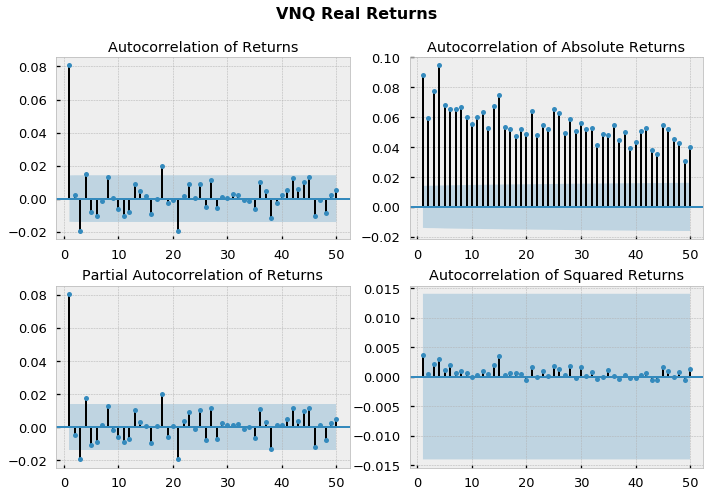

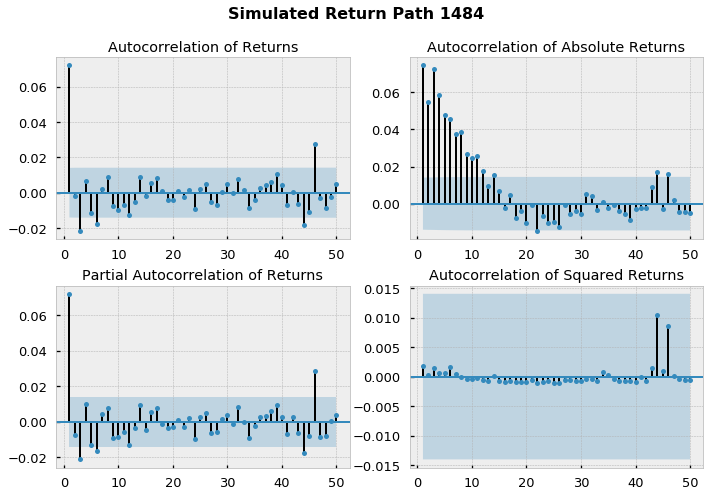

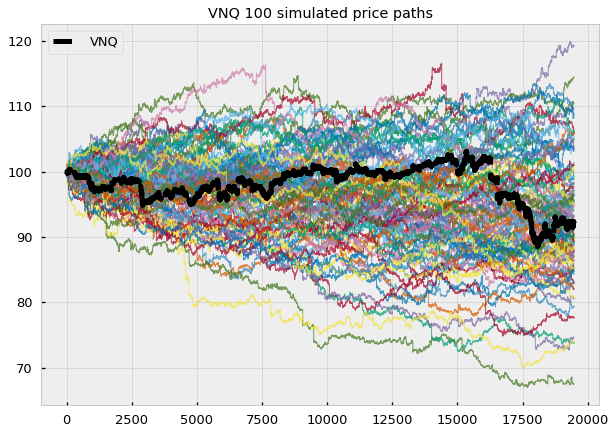

In [48]:
bsize = 20
sim_dict = dict()

for sec in etfs:
    tmp = etfs[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

### Rolling Volatility

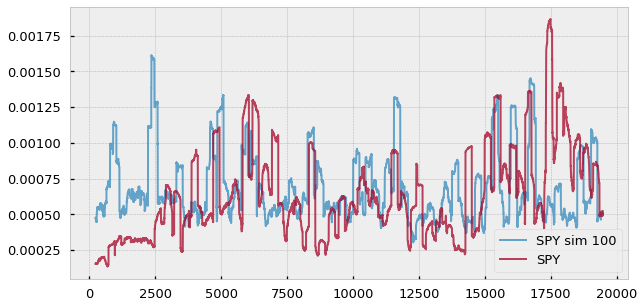

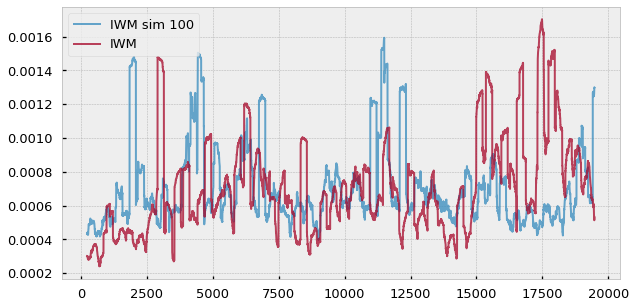

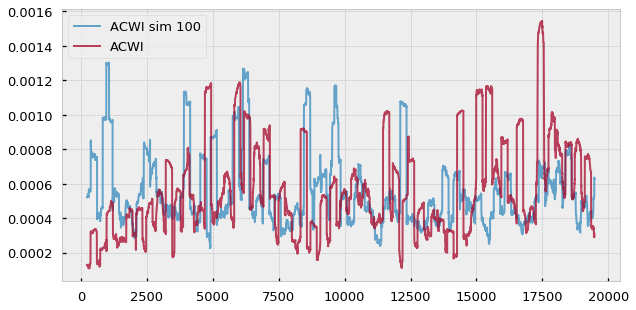

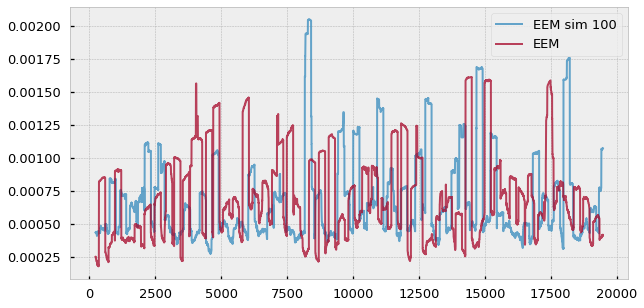

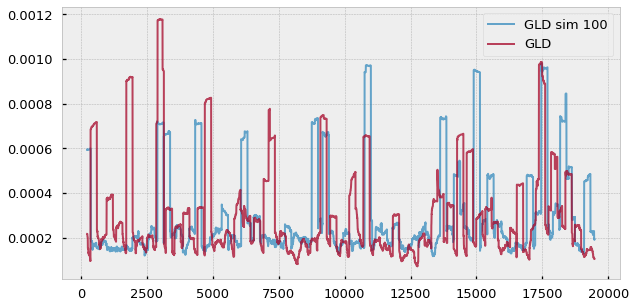

...

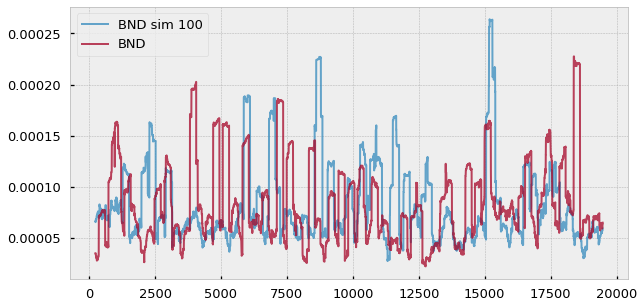

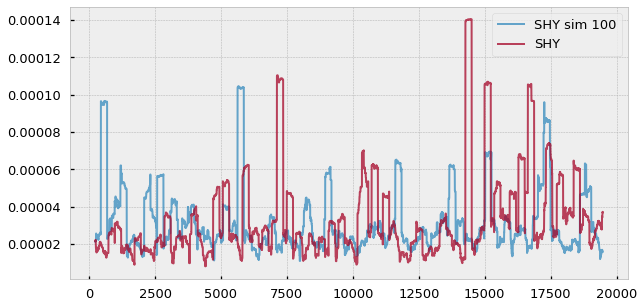

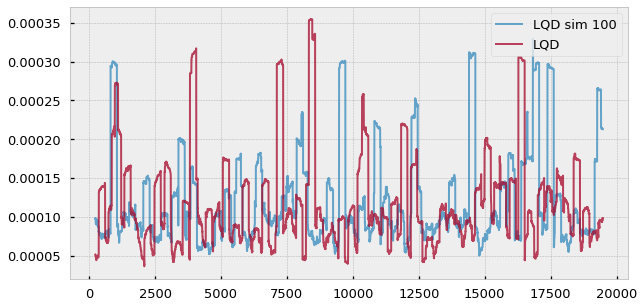

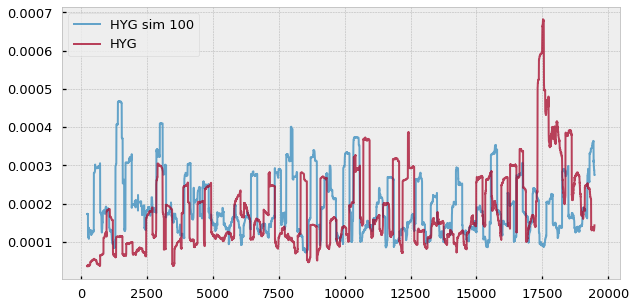

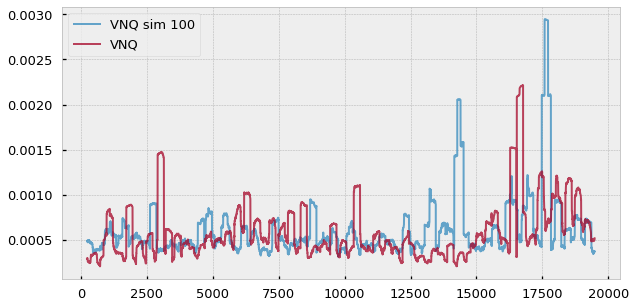

In [50]:
sim_no = 100
window = 240
for sym in etfs.columns:
    fig, ax = plt.subplots(figsize=(10,5))
    sim_dict[sym][sim_no].rolling(window).std().plot(ax=ax,
        label=f'{sym} sim {sim_no}',alpha=0.75)
    etfs[sym].reset_index(drop=True).rolling(window).std().plot(ax=ax, alpha=0.75)
    ax.legend()